In [1]:
import os 
import cv2
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import keras 
from keras.callbacks import EarlyStopping,ModelCheckpoint
import tensorflow as tf
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from tqdm import tqdm
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split

In [2]:
def data(dataset_path):
    images = []
    labels = []
    for folder in os.listdir(dataset_path):
        subfolder_path = os.path.join(dataset_path, folder)
        for subfolder in os.listdir(subfolder_path):
            subfolder_path1 = os.path.join(subfolder_path, subfolder)
            if not os.path.isdir(subfolder_path):
                continue
            for image_filename in os.listdir(subfolder_path1):               
                if image_filename.endswith(".jpg"):
                    image_path = os.path.join(subfolder_path1, image_filename)
                    images.append(image_path)
                    labels.append(subfolder)
    df = pd.DataFrame({'image': images, 'label': labels})
    return df

In [3]:
#train
train=data(r'c:\Users\91628\Downloads\skin\Skin cancer ISIC The International Skin Imaging Collaboration')
train.head()

,image,label
0,c:\Users\91628\Downloads\skin\Skin cancer ISIC...,actinic keratosis
1,c:\Users\91628\Downloads\skin\Skin cancer ISIC...,actinic keratosis
2,c:\Users\91628\Downloads\skin\Skin cancer ISIC...,actinic keratosis
3,c:\Users\91628\Downloads\skin\Skin cancer ISIC...,actinic keratosis
4,c:\Users\91628\Downloads\skin\Skin cancer ISIC...,actinic keratosis


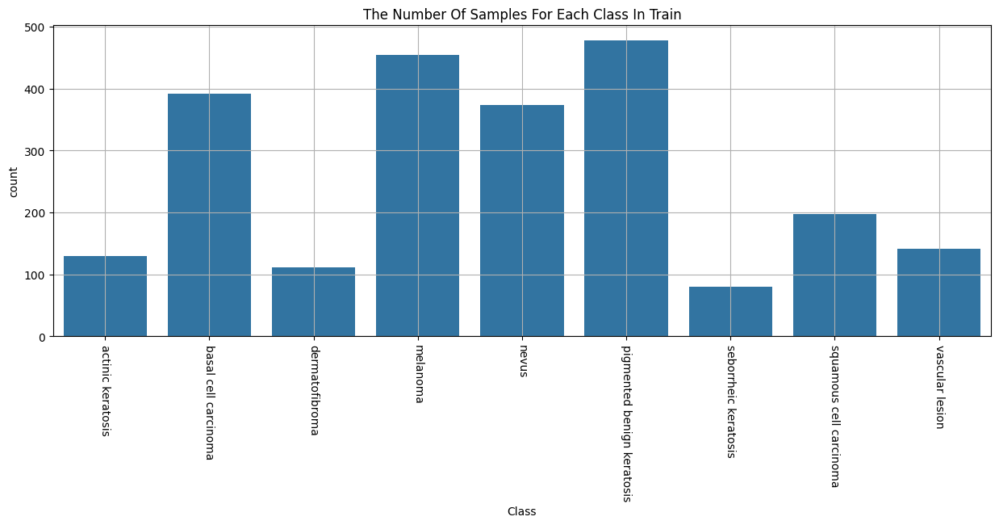

In [4]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(15,5))
ax = sns.countplot(x=train.label)
ax.set_xlabel("Class")
plt.title("The Number Of Samples For Each Class In Train")
plt.grid(True)
plt.xticks(rotation=-90)
plt.show()

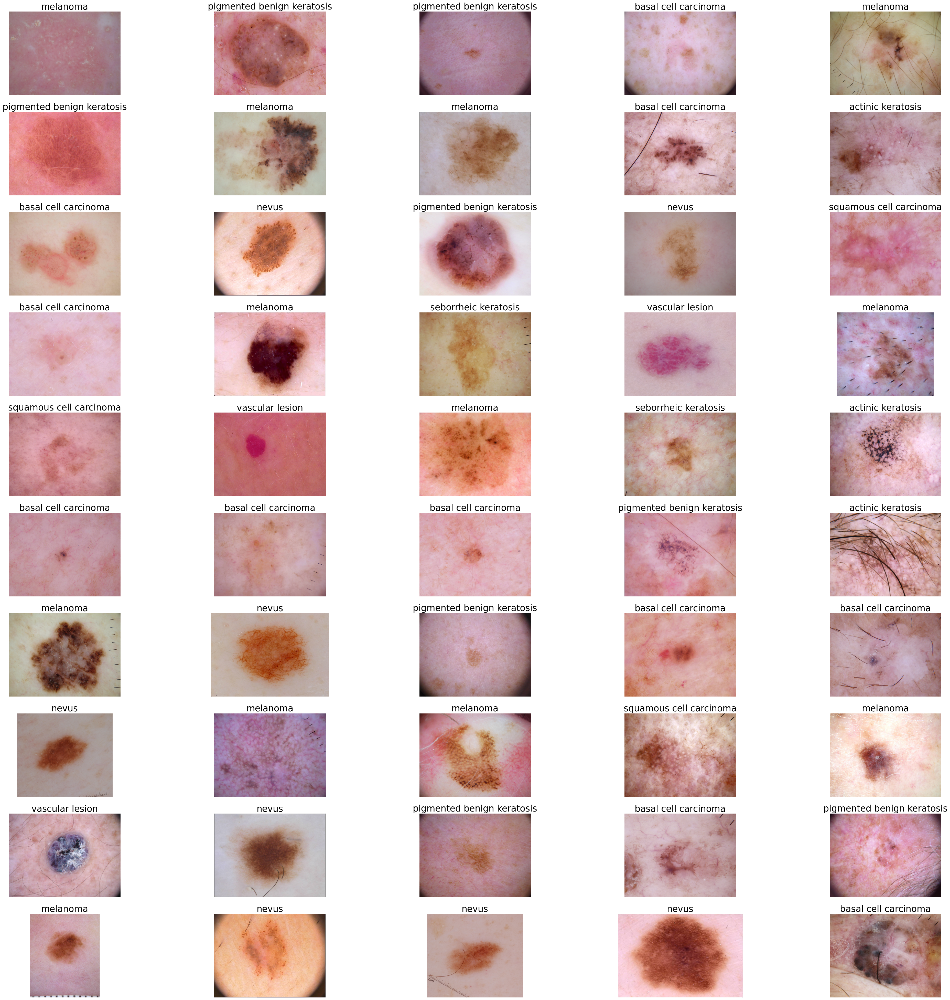

In [5]:
plt.figure(figsize=(50,50))
for n,i in enumerate(np.random.randint(0,len(train),50)):
    plt.subplot(10,5,n+1)
    img=cv2.imread(train.image[i])
    img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.axis('off')
    plt.title(train.label[i],fontsize=25)

In [7]:
df_train,df_test = train_test_split(train,test_size=.2,stratify=train.label,shuffle=True,random_state=41)

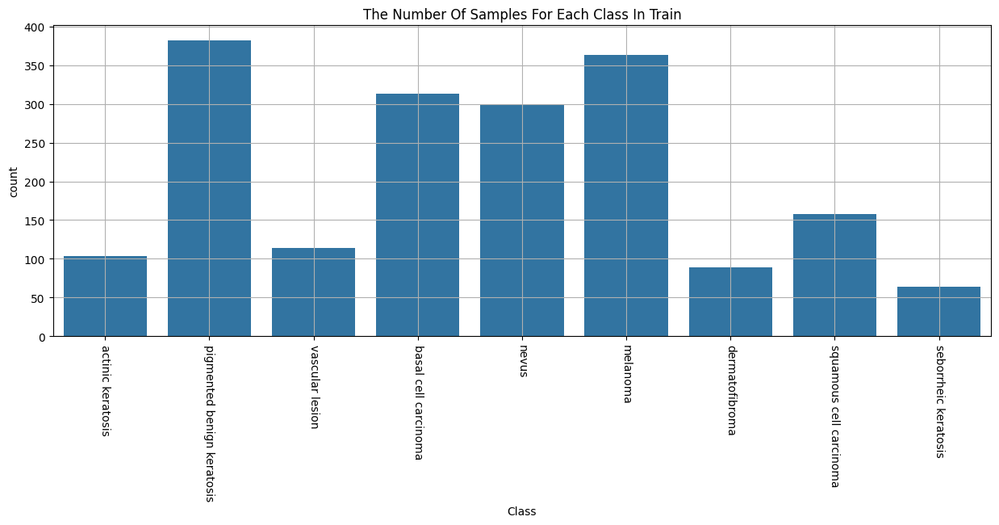

In [8]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(15,5))
ax = sns.countplot(x=df_train.label)
ax.set_xlabel("Class")
plt.title("The Number Of Samples For Each Class In Train")
plt.grid(True)
plt.xticks(rotation=-90)
plt.show()

In [9]:
image_size = (176, 176)
batch_size = 1700 
# Define ImageDataGenerator with Data Augmentation
datagen = ImageDataGenerator(
    rescale=1./255,
)

# Train Data Generator
train_generator = datagen.flow_from_dataframe(
    df_train,
    x_col='image',
    y_col='label',
    target_size=image_size,
    batch_size=batch_size,
    shuffle=True
)

# Test Data Generator (No Augmentation, Only Rescaling)
test_datagen = ImageDataGenerator(rescale=1./255)
test_generator = test_datagen.flow_from_dataframe(
    df_test,
    x_col='image',
    y_col='label',
    target_size=image_size,
    batch_size=batch_size,
    shuffle=False
)


Found 1885 validated image filenames belonging to 9 classes.
Found 472 validated image filenames belonging to 9 classes.


In [10]:
train_iter = iter(train_generator)
train_data, train_labels = next(train_iter)

In [11]:
sm = SMOTE(random_state=41)
train_data, train_labels = sm.fit_resample(train_data.reshape(-1, 176 * 176 * 3), train_labels)
train_data = train_data.reshape(-1, 176,176, 3)
print(train_data.shape, train_labels.shape)

(3123, 176, 176, 3) (3123, 9)


In [12]:
class_num=list(train_generator.class_indices.keys())
class_num

['actinic keratosis',
 'basal cell carcinoma',
 'dermatofibroma',
 'melanoma',
 'nevus',
 'pigmented benign keratosis',
 'seborrheic keratosis',
 'squamous cell carcinoma',
 'vascular lesion']

C:\Users\91628\AppData\Local\Temp\ipykernel_19800\153329692.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(x=labels,palette='Set1')


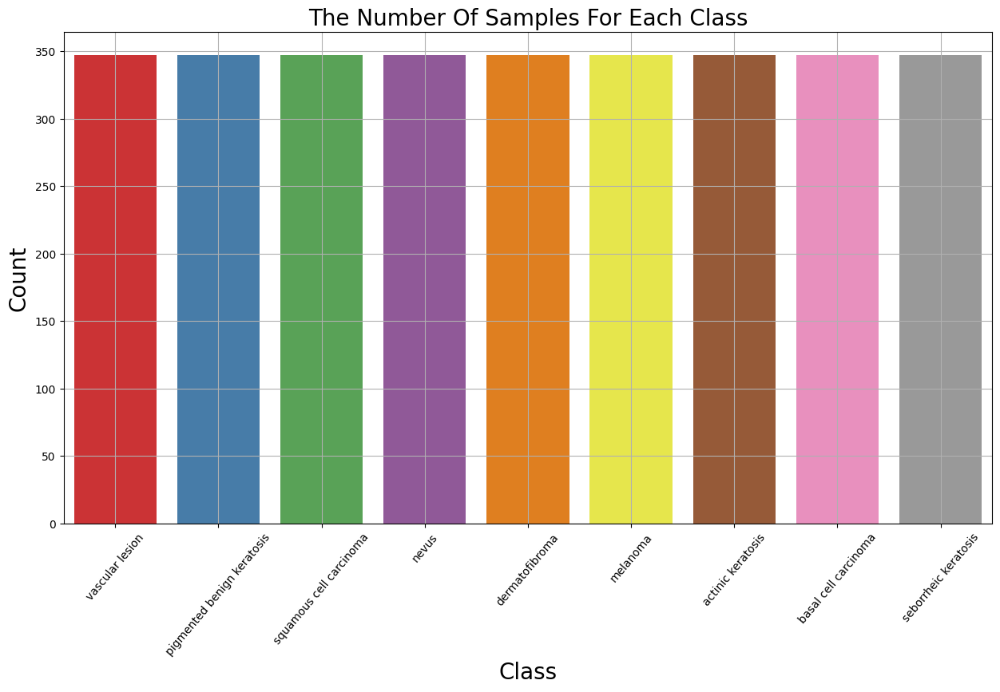

In [13]:
labels=[class_num[i] for i in np.argmax(train_labels,axis=1) ]
plt.figure(figsize=(15,8))
ax = sns.countplot(x=labels,palette='Set1')
ax.set_xlabel("Class",fontsize=20)
ax.set_ylabel("Count",fontsize=20)
plt.title('The Number Of Samples For Each Class',fontsize=20)
plt.grid(True)
plt.xticks(rotation=50)
plt.show()

In [14]:
model=keras.models.Sequential()
model.add(keras.layers.Conv2D(32,kernel_size=(3,3),strides=2,padding='same',activation='relu',input_shape=(176,176,3)))
model.add(keras.layers.MaxPool2D(pool_size=(2,2),strides=2,padding='same'))
model.add(keras.layers.Conv2D(64,kernel_size=(3,3),strides=2,activation='relu',padding='same'))
model.add(keras.layers.MaxPool2D((2,2),2,padding='same'))
model.add(keras.layers.Conv2D(128,kernel_size=(3,3),strides=2,activation='relu',padding='same'))
model.add(keras.layers.MaxPool2D((2,2),2,padding='same'))
model.add(keras.layers.Flatten())
model.add(keras.layers.Dense(1024,activation='relu'))
model.add(keras.layers.Dropout(0.3))
model.add(keras.layers.Dense(9,activation='softmax'))
model.summary()



Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 88, 88, 32)        896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 44, 44, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 22, 22, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 11, 11, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 6, 6, 128)         73856     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 3, 3, 128)        

In [15]:
checkpoint_cb =ModelCheckpoint("my_keras_model.keras", save_best_only=True)
early_stopping_cb =EarlyStopping(patience=5, restore_best_weights=True)
model.compile(optimizer ='adam', loss='categorical_crossentropy', metrics=['accuracy',keras.metrics.SpecificityAtSensitivity(0.5),keras.metrics.AUC()])
hist=model.fit(train_data,train_labels,validation_split=.1,epochs=55,callbacks=[checkpoint_cb,early_stopping_cb])


Epoch 1/55


88/88 [==============================] - 5s 44ms/step - loss: 2.1369 - accuracy: 0.1466 - specificity_at_sensitivity: 0.5344 - auc: 0.5914 - val_loss: 2.7225 - val_accuracy: 0.0000e+00 - val_specificity_at_sensitivity: 0.1286 - val_auc: 0.1499
Epoch 2/55
88/88 [==============================] - 3s 37ms/step - loss: 1.7949 - accuracy: 0.2940 - specificity_at_sensitivity: 0.8240 - auc: 0.7737 - val_loss: 2.8340 - val_accuracy: 0.0000e+00 - val_specificity_at_sensitivity: 0.3095 - val_auc: 0.3685
Epoch 3/55
88/88 [==============================] - 4s 45ms/step - loss: 1.6677 - accuracy: 0.3644 - specificity_at_sensitivity: 0.8690 - auc: 0.8127 - val_loss: 1.6850 - val_accuracy: 0.3578 - val_specificity_at_sensitivity: 0.7943 - val_auc: 0.8010
Epoch 4/55
88/88 [==============================] - 5s 53ms/step - loss: 1.4977 - accuracy: 0.4164 - specificity_at_sensitivity: 0.9149 - auc: 0.8545 - val_loss: 0.9645 - val_accuracy: 0.5942 - val_specificity_at_sensitivity: 0.9988 - v

In [16]:
hist_=pd.DataFrame(hist.history)
hist_

,loss,accuracy,specificity_at_sensitivity,auc,val_loss,val_accuracy,val_specificity_at_sensitivity,val_auc
0,2.136938,0.146619,0.534431,0.591441,2.722480,0.000000,0.128594,0.149906
1,1.794862,0.293950,0.823977,0.773713,2.834006,0.000000,0.309505,0.368472
2,1.667653,0.364413,0.868950,0.812726,1.685031,0.357827,0.794329,0.801031
3,1.497723,0.416370,0.914858,0.854498,0.964459,0.594249,0.998802,0.940325
4,1.406393,0.473665,0.932785,0.873221,0.900382,0.629393,0.998802,0.949510
5,1.290706,0.504270,0.944573,0.894118,0.897792,0.638978,0.998003,0.946447
6,1.266020,0.528826,0.953826,0.898683,0.787609,0.702875,0.998802,0.960991
7,1.129783,0.581851,0.967393,0.920041,0.517465,0.798722,1.000000,0.983814
8,1.078955,0.602491,0.971085,0.926519,0.612895,0.773163,1.000000,0.976062
9,0.997672,0.634520,0.978158,0.937397,0.471608,0.821086,1.000000,0.986687


15/15 [==============================] - 0s 9ms/step


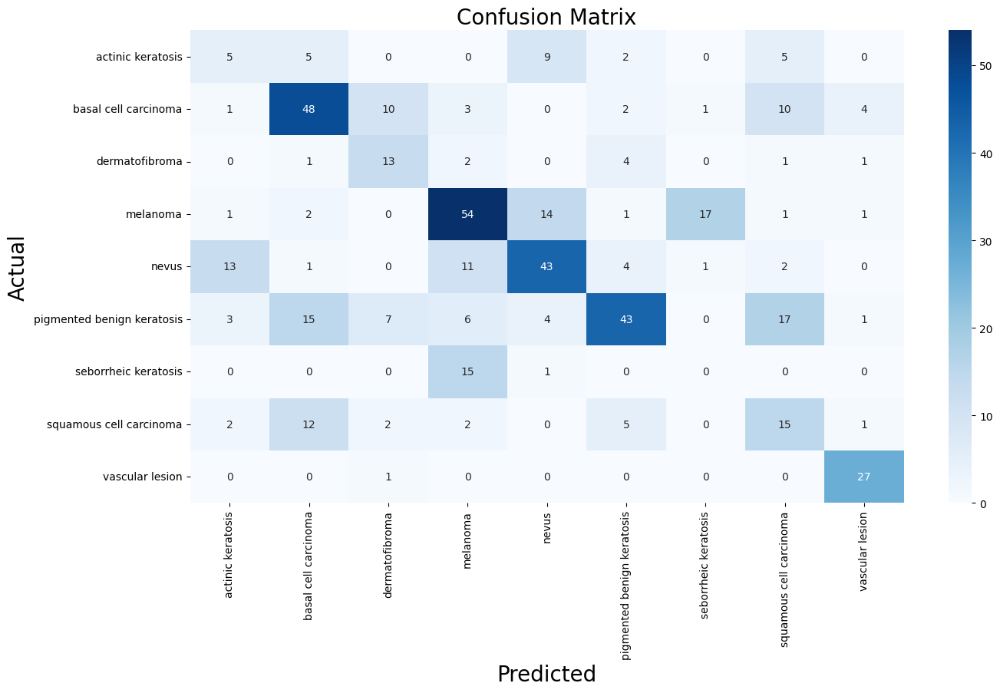

In [17]:
#confusion matrix
test_iter = iter(test_generator)
test_data, test_labels = next(test_iter)
test_pred = model.predict(test_data)
test_labels = np.argmax(test_labels, axis=1)
test_pred = np.argmax(test_pred, axis=1)
cm = confusion_matrix(test_labels, test_pred)
cm = pd.DataFrame(cm, index=class_num, columns=class_num)

plt.figure(figsize=(15,8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted',fontsize=20)
plt.ylabel('Actual',fontsize=20)
plt.title('Confusion Matrix',fontsize=20)
plt.show()

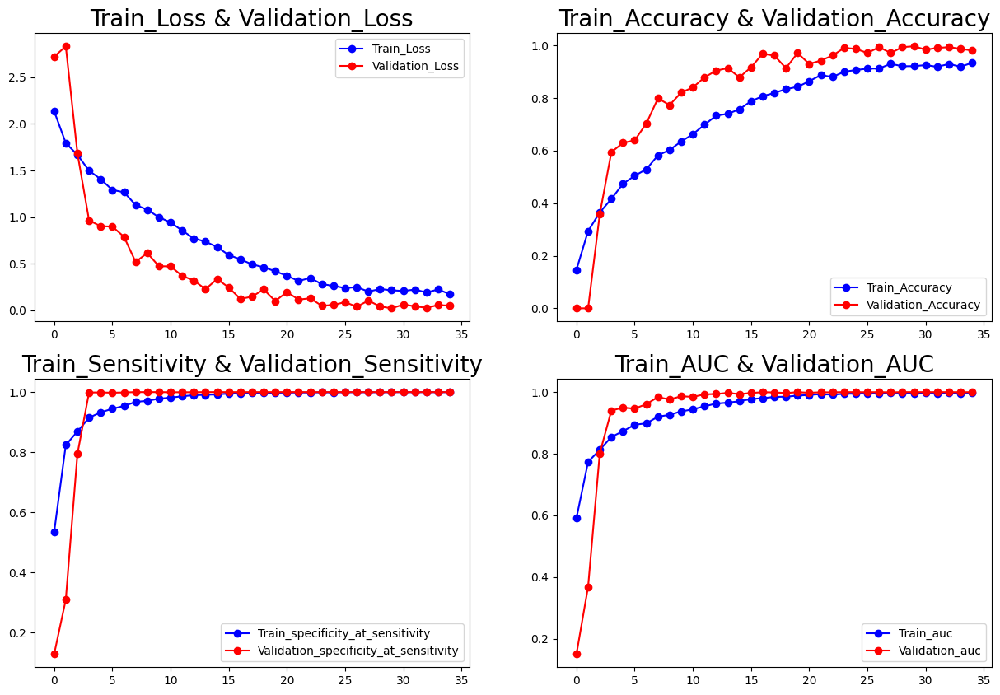

In [18]:
plt.figure(figsize=(15,10))
plt.subplot(2,2,1)
plt.plot(hist_.iloc[:,0],'b-o',label='Train_Loss')
plt.plot(hist_.iloc[:,4],'r-o',label='Validation_Loss')
plt.title('Train_Loss & Validation_Loss',fontsize=20)
plt.legend()
plt.subplot(2,2,2)
plt.plot(hist_.iloc[:,1],'b-o',label='Train_Accuracy')
plt.plot(hist_.iloc[:,5],'r-o',label='Validation_Accuracy')
plt.title('Train_Accuracy & Validation_Accuracy',fontsize=20)
plt.legend()
plt.subplot(2,2,3)
plt.plot(hist_.iloc[:,2],'b-o',label='Train_specificity_at_sensitivity')
plt.plot(hist_.iloc[:,6],'r-o',label='Validation_specificity_at_sensitivity')
plt.title('Train_Sensitivity & Validation_Sensitivity',fontsize=20)
plt.legend()
plt.subplot(2,2,4)
plt.plot(hist_.iloc[:,3],'b-o',label='Train_auc')
plt.plot(hist_.iloc[:,7],'r-o',label='Validation_auc')
plt.title('Train_AUC & Validation_AUC',fontsize=20)
plt.legend()
plt.show()

In [19]:
#classification report on train data
train_pred = model.predict(train_data)
train_labels = np.argmax(train_labels, axis=1)
train_pred = np.argmax(train_pred, axis=1)
print(classification_report(train_labels, train_pred, target_names=class_num))


98/98 [==============================] - 1s 9ms/step
                            precision    recall  f1-score   support

         actinic keratosis       0.89      0.94      0.91       347
      basal cell carcinoma       0.96      0.93      0.94       347
            dermatofibroma       0.90      1.00      0.95       347
                  melanoma       0.87      0.92      0.90       347
                     nevus       0.93      0.86      0.89       347
pigmented benign keratosis       0.99      0.84      0.91       347
      seborrheic keratosis       0.92      0.88      0.90       347
   squamous cell carcinoma       0.94      0.99      0.96       347
           vascular lesion       0.97      1.00      0.99       347

                  accuracy                           0.93      3123
                 macro avg       0.93      0.93      0.93      3123
              weighted avg       0.93      0.93      0.93      3123



In [20]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 88, 88, 32)        896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 44, 44, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 22, 22, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 11, 11, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 6, 6, 128)         73856     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 3, 3, 128)         0

In [21]:
y_test =test_generator.classes
predictions = model.predict(test_generator)
y_pred = np.argmax(predictions,axis=1)
y_test = np.ravel(y_test)
y_pred = np.ravel(y_pred)
df = pd.DataFrame({'Actual': y_test, 'Prediction': y_pred})
df

1/1 [==============================] - 3s 3s/step


,Actual,Prediction
0,5,1
1,4,0
2,4,4
3,3,4
4,8,8
...,...,...
467,5,7
468,3,4
469,5,5
470,6,3


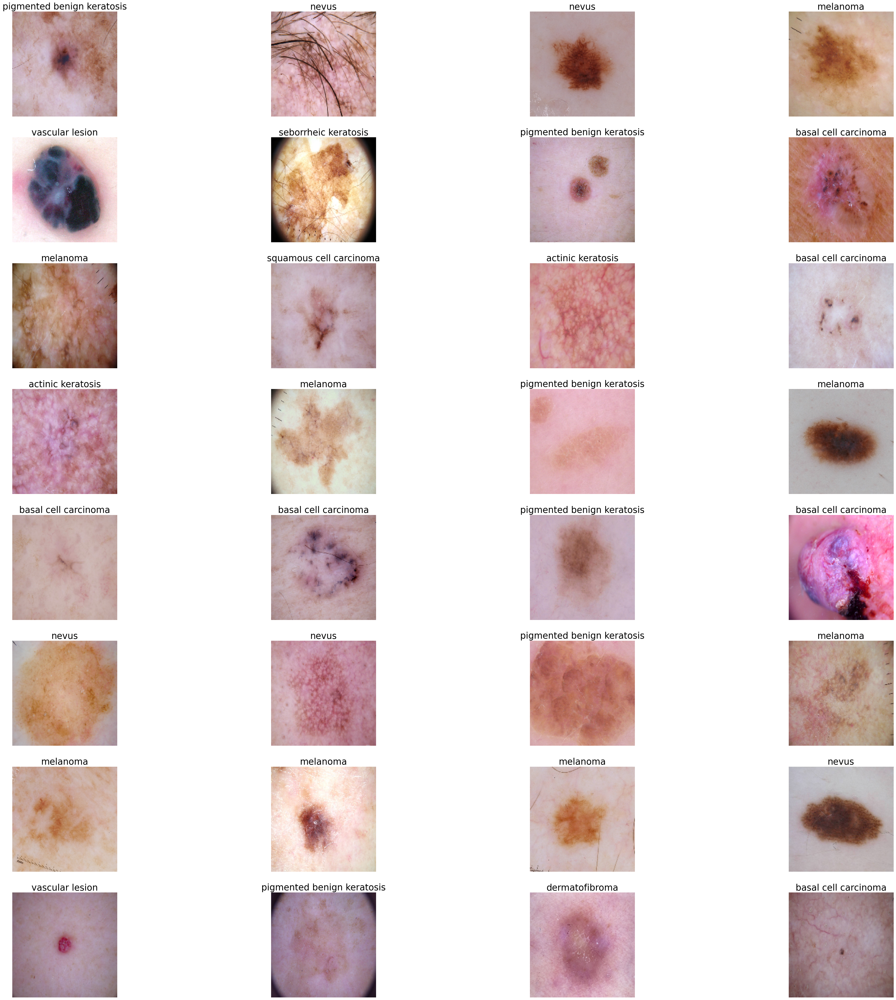

In [22]:
batch = next(test_generator)
images= batch[0]
plt.figure(figsize=(50,50))
for n in range(32):
    plt.subplot(8,4,n+1)
    plt.imshow(images[n])
    plt.axis('off')
    plt.title(class_num[int(y_test[n])],fontsize=25)

array([[ 5,  5,  0,  0,  9,  2,  0,  5,  0],
       [ 1, 48, 10,  3,  0,  2,  1, 10,  4],
       [ 0,  1, 13,  2,  0,  4,  0,  1,  1],
       [ 1,  2,  0, 54, 14,  1, 17,  1,  1],
       [13,  1,  0, 11, 43,  4,  1,  2,  0],
       [ 3, 15,  7,  6,  4, 43,  0, 17,  1],
       [ 0,  0,  0, 15,  1,  0,  0,  0,  0],
       [ 2, 12,  2,  2,  0,  5,  0, 15,  1],
       [ 0,  0,  1,  0,  0,  0,  0,  0, 27]], dtype=int64)

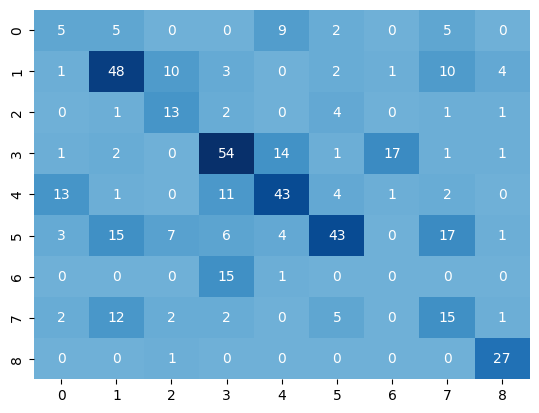

In [23]:
CM = confusion_matrix(y_test,y_pred)
sns.heatmap(CM,fmt='g',center = True,cbar=False,annot=True,cmap='Blues')
CM

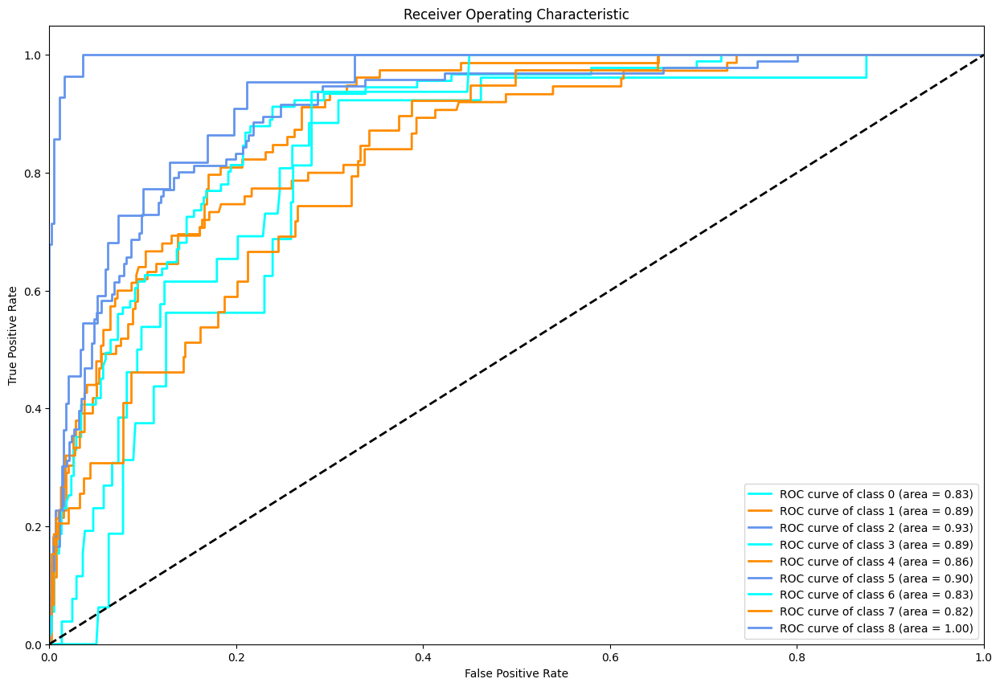

In [24]:
#roc curve
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score
from itertools import cycle

y_test = label_binarize(y_test, classes=[0, 1, 2, 3, 4, 5, 6, 7, 8])
n_classes = y_test.shape[1]
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test[:, i], predictions[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
colors = cycle(['aqua', 'darkorange', 'cornflowerblue'])
plt.figure(figsize=(15,10))
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")


In [54]:
model.save('cancer.h5')

C:\Users\91628\AppData\Roaming\Python\Python311\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [26]:
import tensorflow as tf
import numpy as np
import cv2

# Load the saved model
model = tf.keras.models.load_model('model.h5')

# Load and preprocess the image
image_path = r'c:\Users\91628\Downloads\archive (6)\Skin cancer ISIC The International Skin Imaging Collaboration\Train\actinic keratosis\ISIC_0031506.jpg'  # Replace with the actual path to your image
img = cv2.imread(image_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img = cv2.resize(img, (176, 176))  # Resize to match the input size of the model
img = img / 255.0  # Normalize pixel values
img = np.expand_dims(img, axis=0)  # Add batch dimension

# Make prediction
prediction = model.predict(img)
predicted_class_index = np.argmax(prediction)

# Get the class labels from the test generator
class_labels = list(test_generator.class_indices.keys())

# Print the predicted class
print('Predicted class:', class_labels[predicted_class_index])

1/1 [==============================] - 0s 95ms/step
Predicted class: actinic keratosis
